## <center> Kaggle Project :
### <center> Paddy Doctor: Paddy Disease Classification
<center> Kaggle Team: AFES Paddy </center> 

---
Team Members: 
- Annine Duclaire Kenne
- Fenosoa Randrianjatovo	
-	Elysee Manimpire Gasana
-	Abiodun Saheed Ademola

---

In [ ]:
-from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Imports

In [2]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt 
import seaborn as sns 
import os 
from glob import glob
from sklearn.model_selection import train_test_split, KFold
from tqdm import tqdm 
from tensorflow.keras.applications import Xception, VGG19, MobileNet, DenseNet121
from tensorflow.keras.layers import Dense, Flatten, Input, Average 
from tensorflow.keras.models import Model, load_model, Sequential
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

# Data Exploration

In [ ]:
!pip install -q kaggle

In [ ]:
!mkdir ~/.kaggle

In [ ]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"annineduclairekenne","key":"57967807fc772e59a4b4f2e76e841019"}'}

In [ ]:
!cp kaggle.json ~/.kaggle/

In [ ]:
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle competitions download -c paddy-disease-classification

100% 1.02G/1.02G [00:31<00:00, 31.9MB/s]
100% 1.02G/1.02G [00:31<00:00, 35.0MB/s]


In [1]:
!unzip paddy-disease-classification.zip

In [ ]:
data = pd.read_csv('/content/train.csv')

In [ ]:
data.head()

,image_id,label,variety,age
0,100330.jpg,bacterial_leaf_blight,ADT45,45
1,100365.jpg,bacterial_leaf_blight,ADT45,45
2,100382.jpg,bacterial_leaf_blight,ADT45,45
3,100632.jpg,bacterial_leaf_blight,ADT45,45
4,101918.jpg,bacterial_leaf_blight,ADT45,45


In [ ]:
# Analyzing only diseases 
disease_df = data[data['label'] != 'normal']

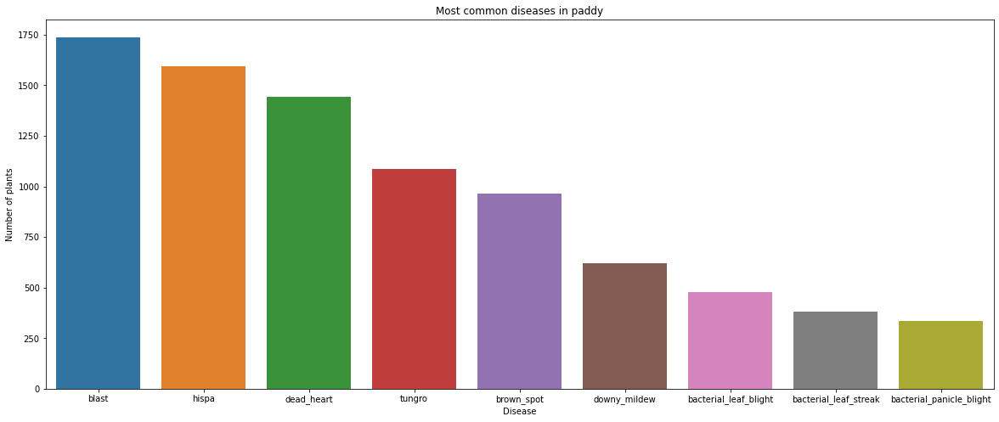

In [ ]:
# Most Common Diseases
_, ax = plt.subplots(figsize=(20,8))
sns.countplot(
    data=disease_df, 
    ax=ax, 
    x='label', 
    order=disease_df['label'].value_counts().index)
ax.set_title('Most common diseases in paddy')
ax.set_xlabel('Disease')
ax.set_ylabel('Number of plants')
plt.show()

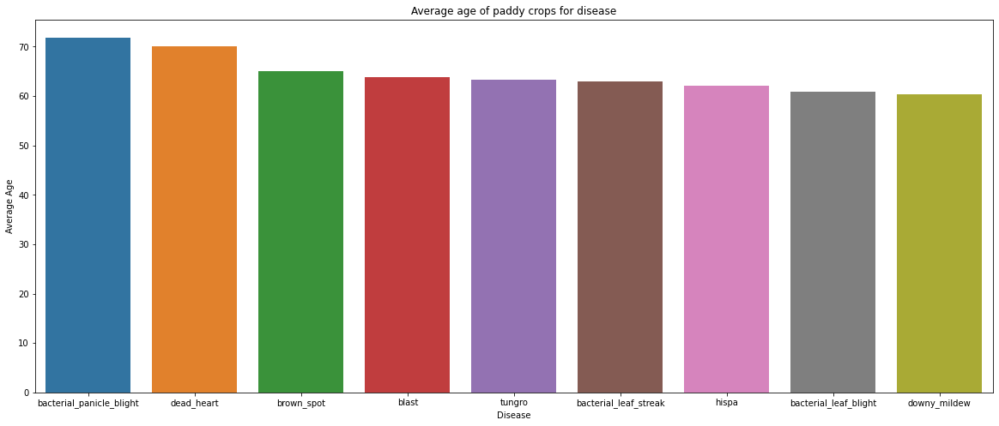

In [ ]:
# Diseases with average age 
age_disease_df = disease_df.groupby(by=['label'])['age'].mean()
_, ax = plt.subplots(figsize=(20,8))
sns.barplot( 
    x=age_disease_df.index,
    y=age_disease_df.values, 
    ax=ax, 
    order=age_disease_df.sort_values(ascending=False).index)
ax.set_xlabel('Disease')
ax.set_ylabel('Average Age')
ax.set_title('Average age of paddy crops for disease')
plt.show()

We can observe that most of the diseased crops are over 60 days old, which may mean that the older paddy crops are getting diseased

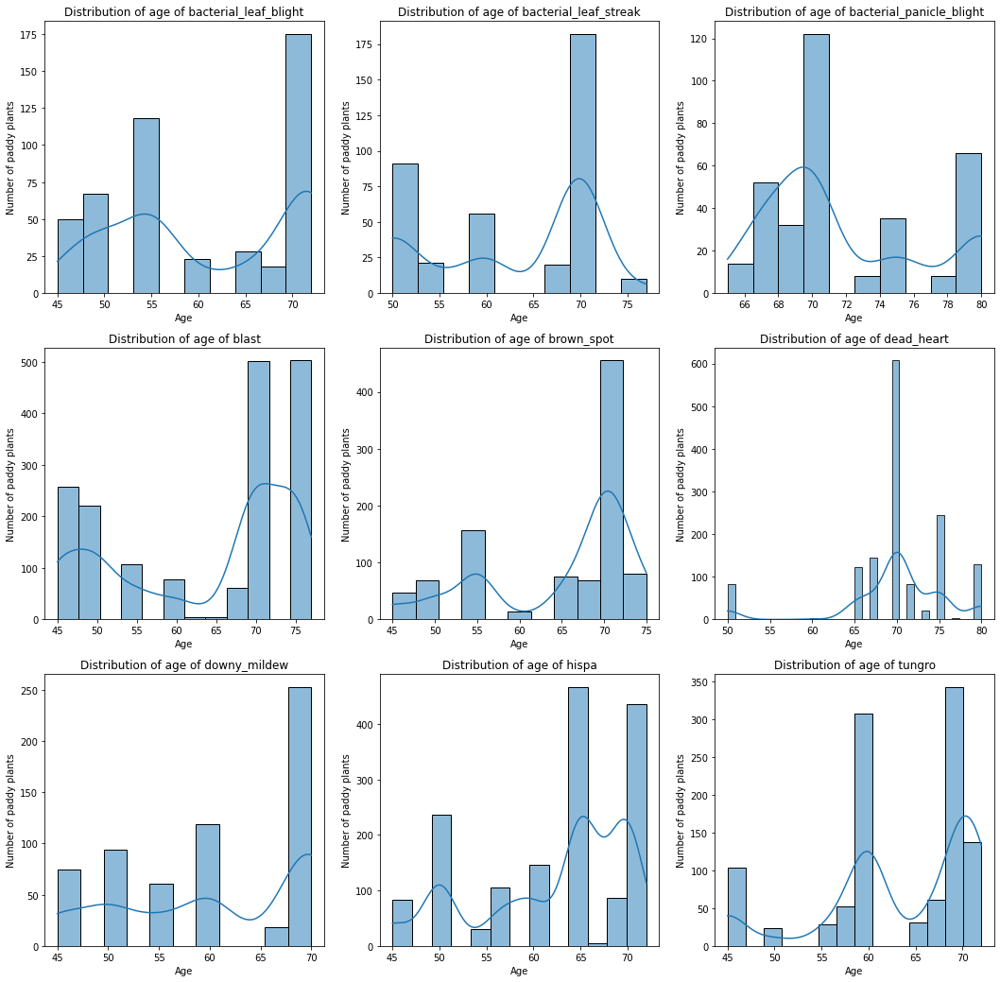

In [ ]:
# Find out the distribution of age of diseased crops 
diseases = disease_df['label'].unique().reshape((3,3))
_, ax = plt.subplots(nrows=3,ncols=3, figsize=(18,18))
for i in range(3):
    for j in range(3):
        disease_data = disease_df[disease_df['label'] == diseases[i,j]]
        sns.histplot(data=disease_data, x='age', kde=True, ax=ax[i,j])
        ax[i,j].set_title(f'Distribution of age of {diseases[i,j]}')
        ax[i,j].set_xlabel('Age')
        ax[i,j].set_ylabel('Number of paddy plants')
plt.show()

Hence our assumption about older crops being diseased was correct. Mostly older crops are diseased but to an exception, a few younger crops are also diseased

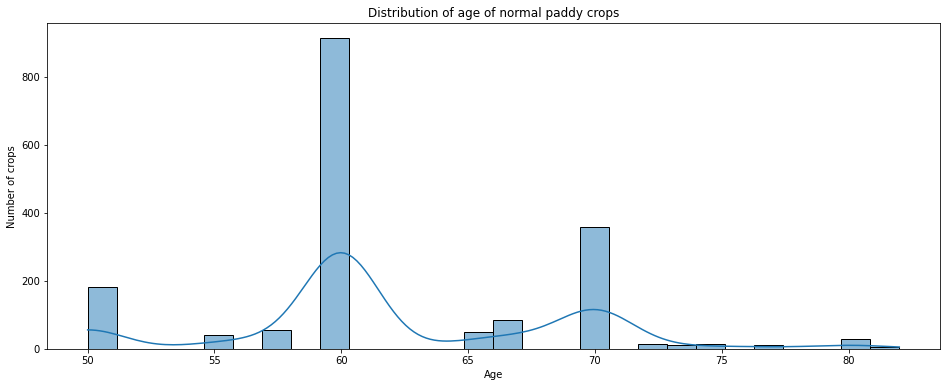

In [ ]:
_, ax = plt.subplots(figsize=(16,6))
sns.histplot(data=data[data['label'] == 'normal'], x='age', ax=ax, kde=True)
ax.set_title('Distribution of age of normal paddy crops')
ax.set_ylabel('Number of crops')
ax.set_xlabel('Age')
plt.show()

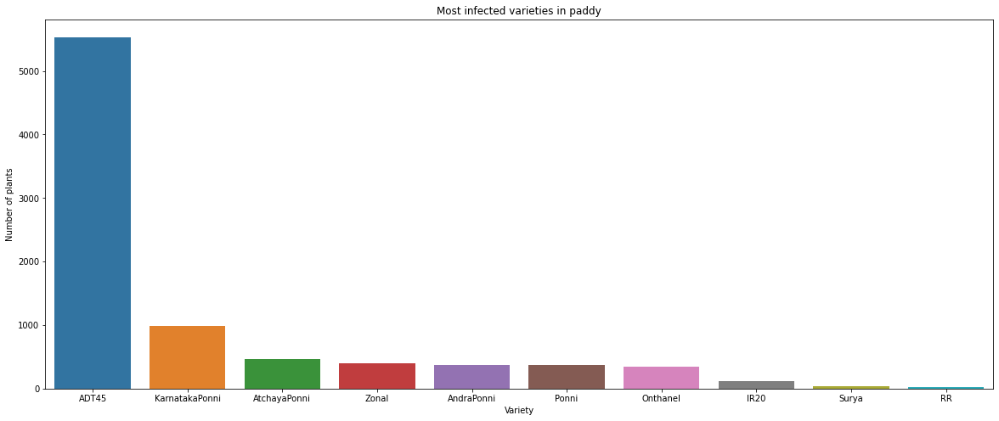

In [ ]:
# Most Infected variety
_, ax = plt.subplots(figsize=(20,8))
sns.countplot(
    data=disease_df,
    ax=ax, 
    x='variety', 
    order=disease_df['variety'].value_counts().index)
ax.set_title('Most infected varieties in paddy')
ax.set_xlabel('Variety')
ax.set_ylabel('Number of plants')
plt.show()

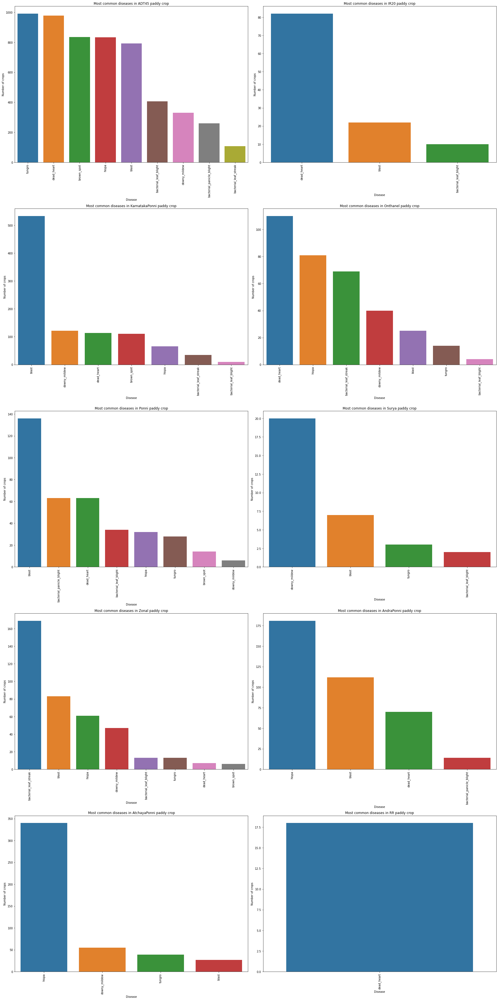

In [ ]:
# Seeing proportion of diseases in each variety of paddy 
varieties = disease_df['variety'].unique().reshape((5,2))
_, ax = plt.subplots(figsize=(25,50), nrows=5,ncols=2)
for i in range(5):
    for j in range(2):
        variety_df = disease_df[disease_df['variety'] == varieties[i,j]]
        sns.countplot(data=variety_df, x='label', ax=ax[i,j], order=variety_df['label'].value_counts().index)
        ax[i,j].set_title(f'Most common diseases in {varieties[i,j]} paddy crop')
        ax[i,j].set_xlabel('Disease')
        ax[i,j].set_ylabel('Number of crops')
        ax[i,j].tick_params(axis='x', labelrotation=90)
plt.tight_layout()
plt.show()

ADT45 is the most infected variety in the paddy crops, it may be because ADT45 is the most common choice of the farmers to grow. Let's look more at ADT 45

In [ ]:
# Separating ADT data
adt_df = disease_df[disease_df['variety']=='ADT45']

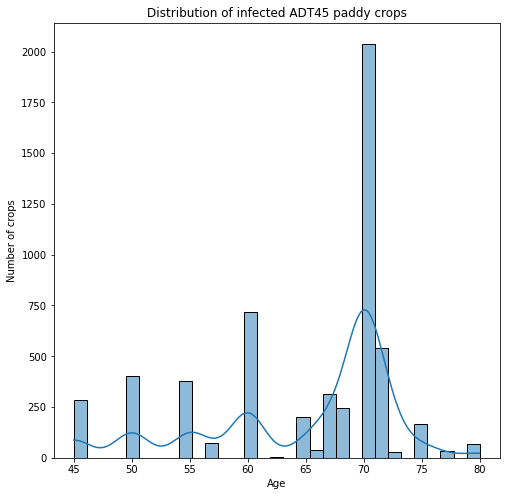

In [ ]:
_, ax = plt.subplots(figsize=(8,8))
sns.histplot(data=adt_df, x='age', ax=ax, kde=True)
ax.set_title('Distribution of infected ADT45 paddy crops')
ax.set_xlabel('Age')
ax.set_ylabel('Number of crops')
plt.show()

In [ ]:
BASE_PATH = '/content/train_images'

Seeing examples of diseased crops for bacterial_leaf_blight


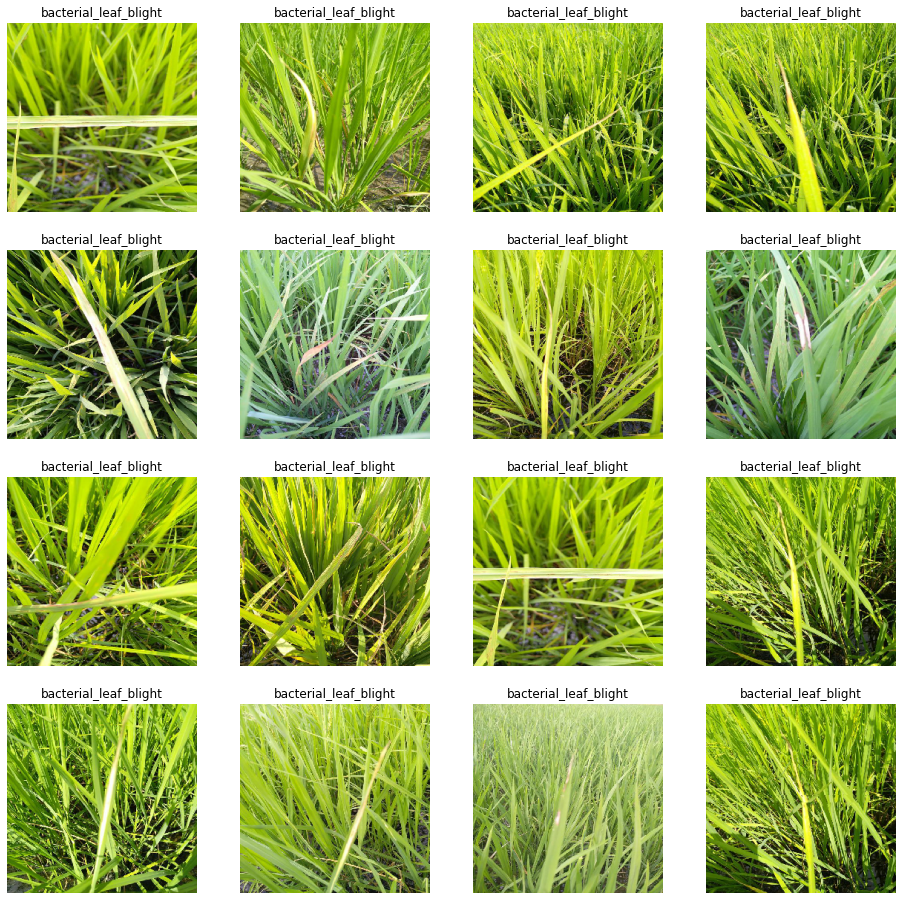

Seeing examples of diseased crops for bacterial_leaf_streak


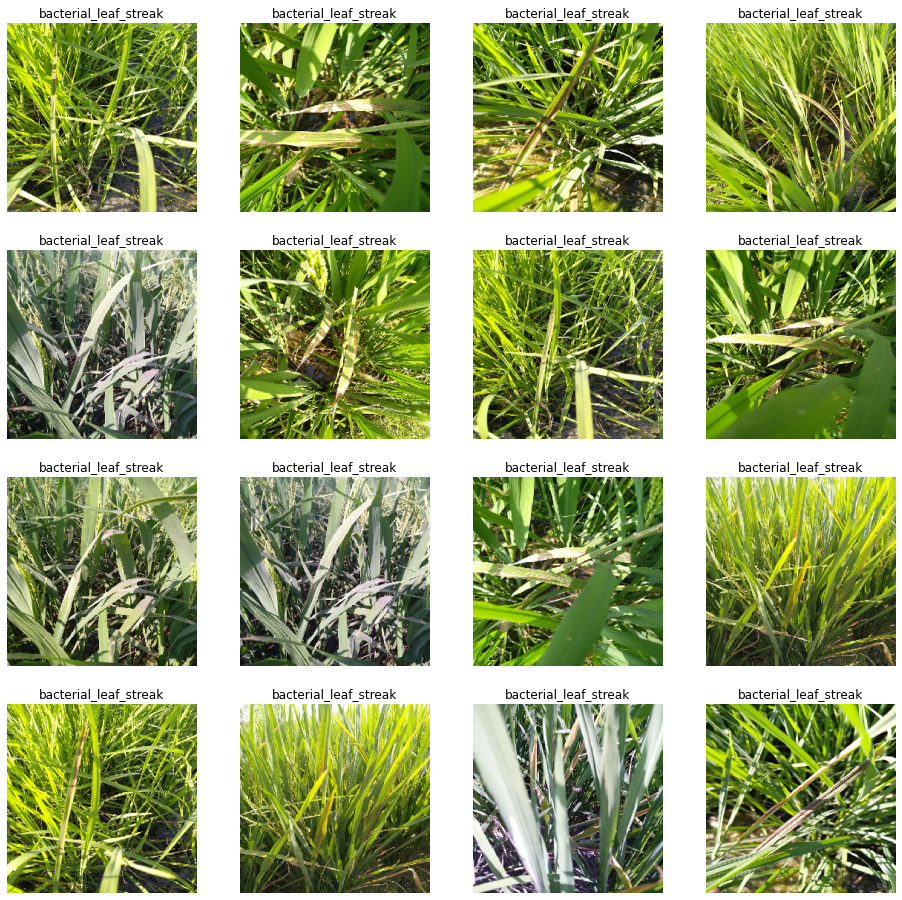

Seeing examples of diseased crops for bacterial_panicle_blight


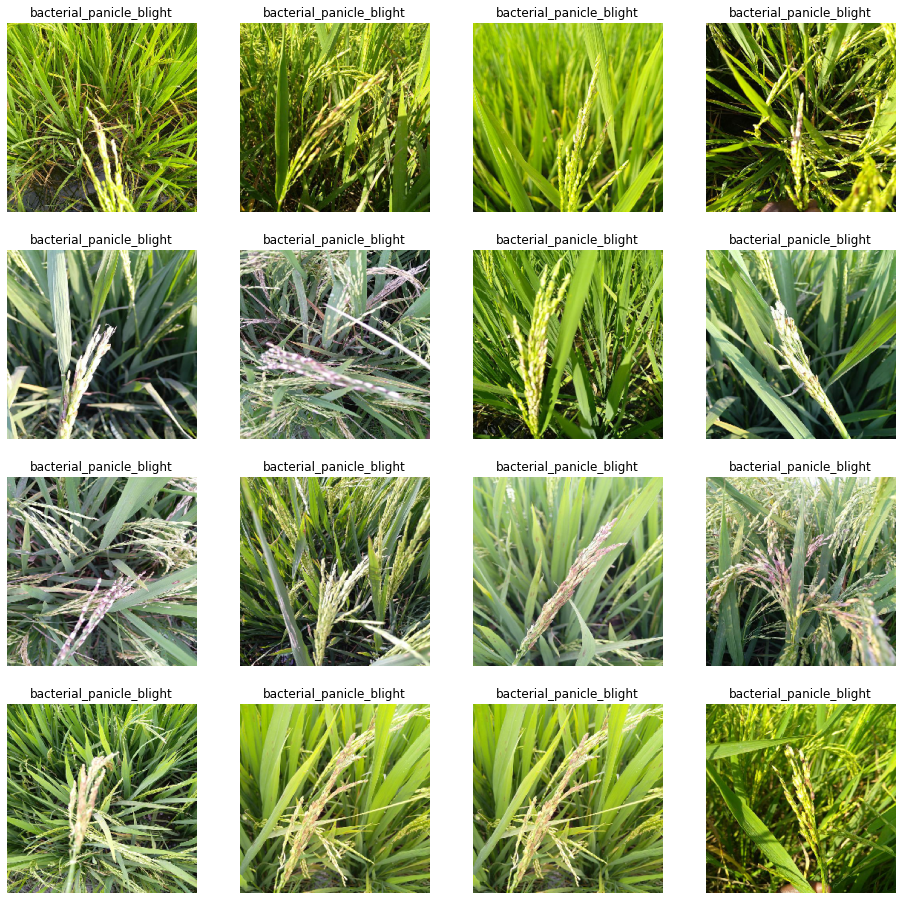

Seeing examples of diseased crops for blast


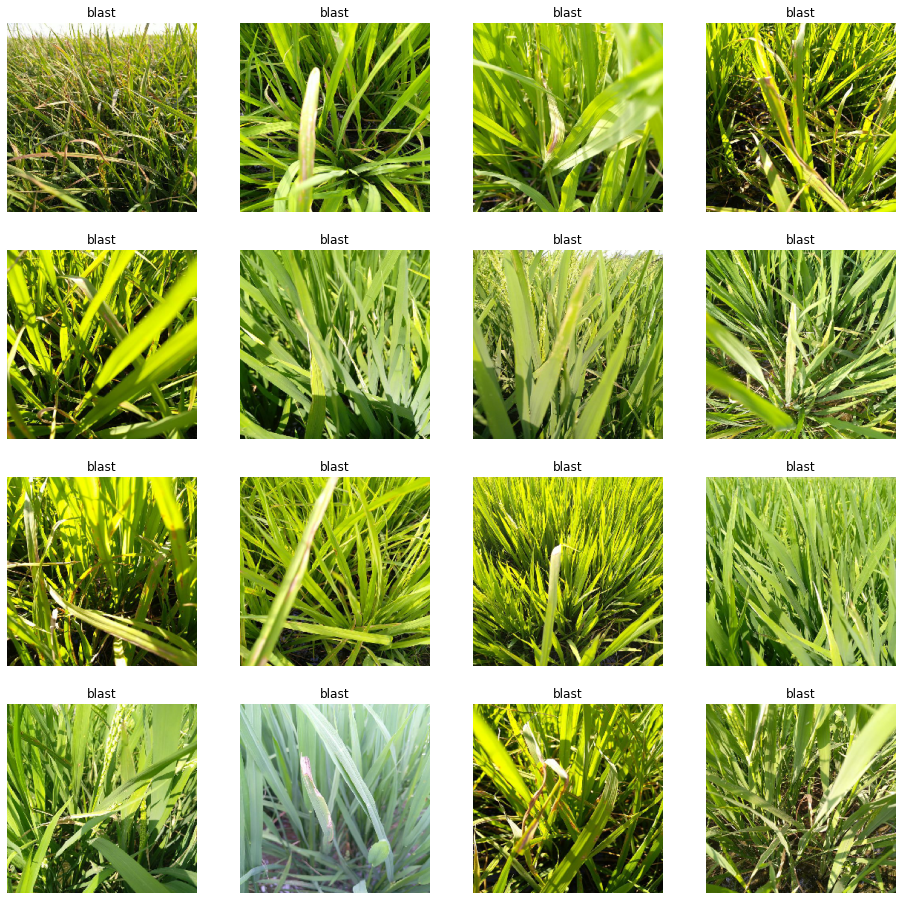

Seeing examples of diseased crops for brown_spot


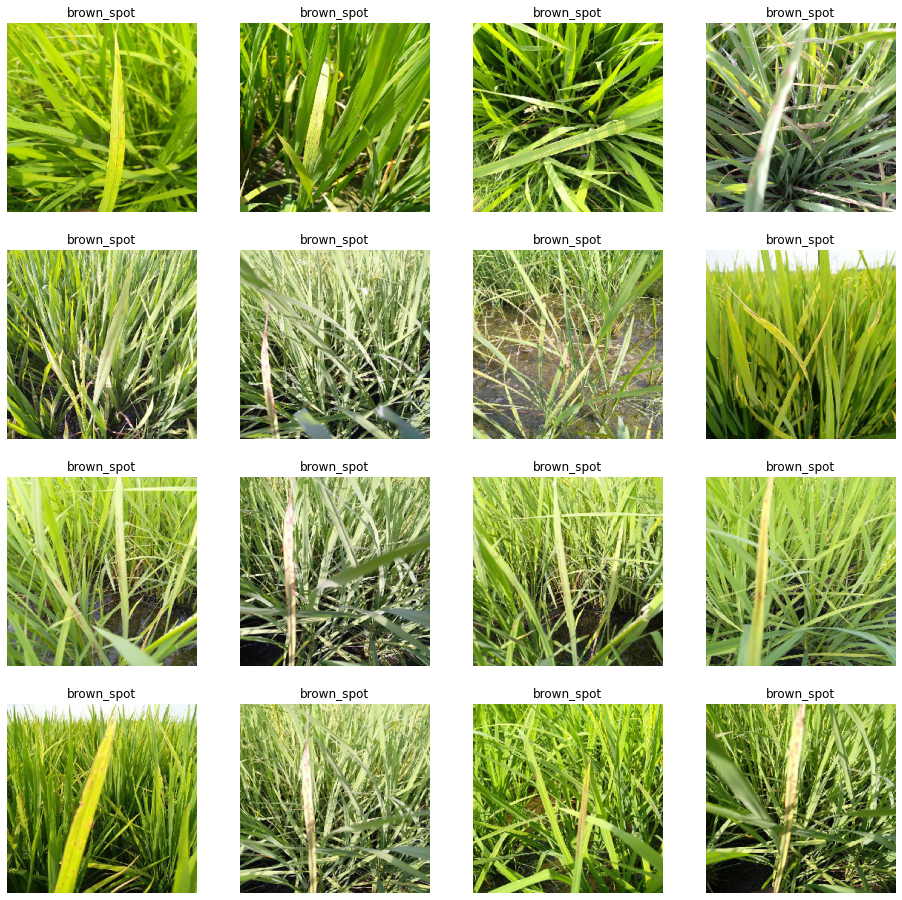

Seeing examples of diseased crops for dead_heart


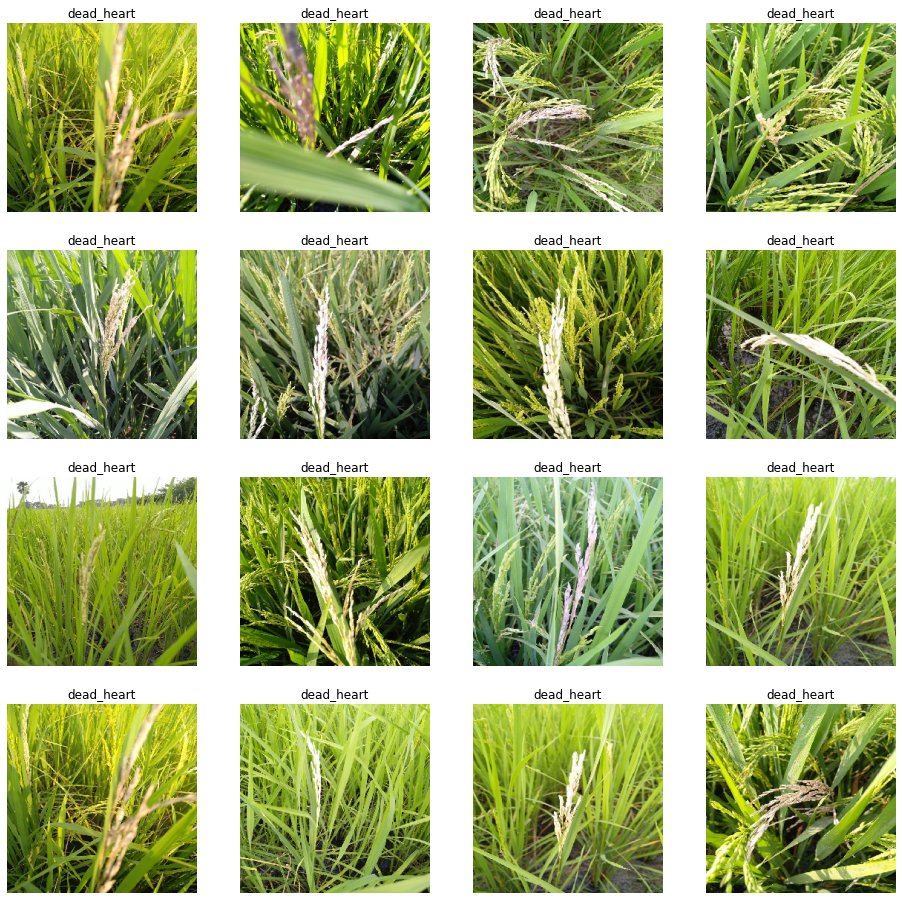

Seeing examples of diseased crops for downy_mildew


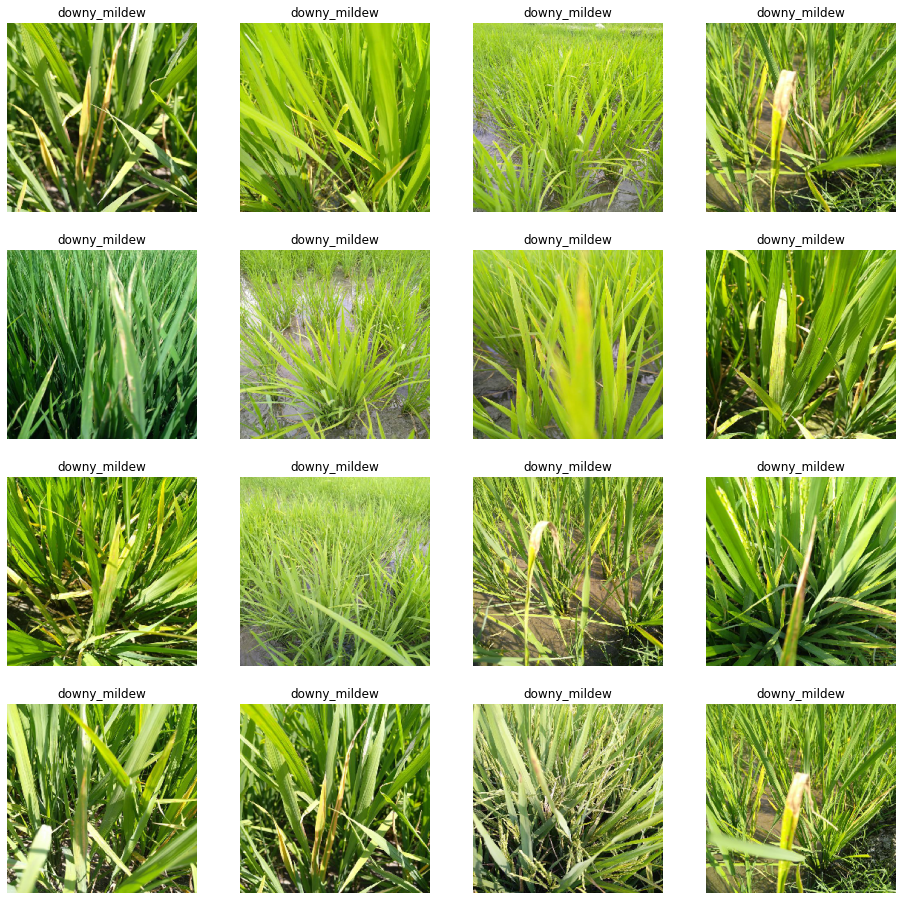

Seeing examples of diseased crops for hispa


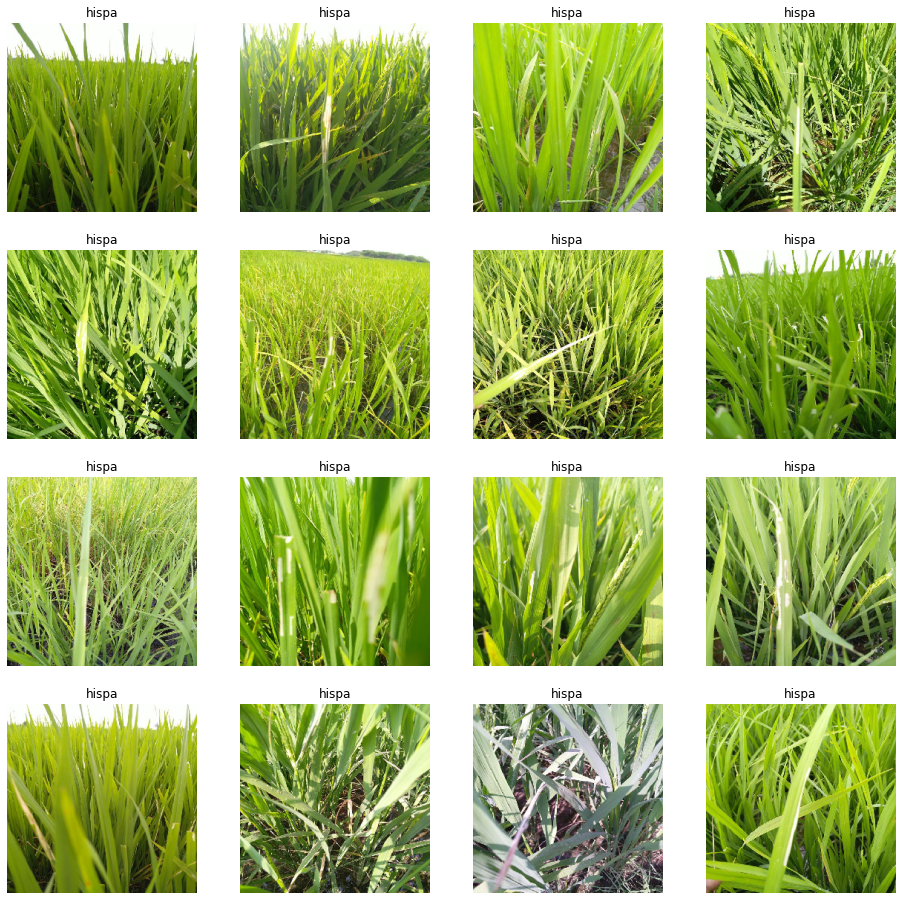

Seeing examples of diseased crops for tungro


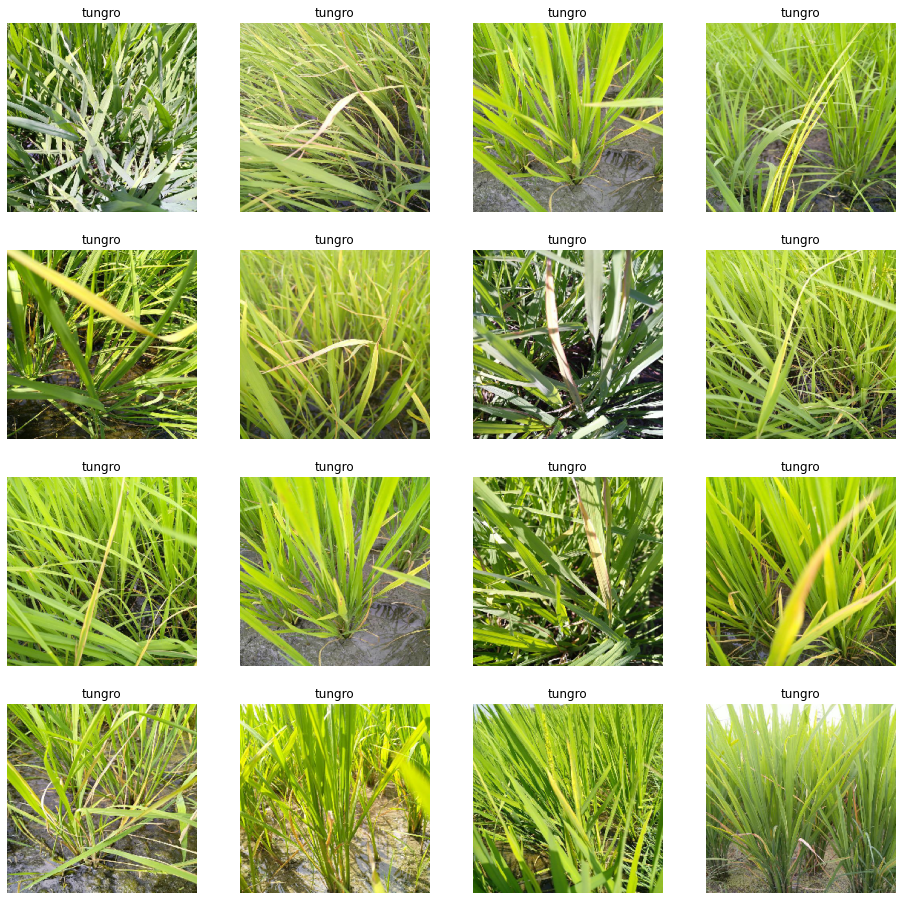

In [ ]:
# Seeing some images of diseased crops infected with each disease
for disease in np.ravel(diseases):
    images_path = os.path.join(BASE_PATH, disease)
    images = np.random.choice(os.listdir(images_path), size=(4,4))
    print(f'Seeing examples of diseased crops for {disease}')
    _, ax = plt.subplots(figsize=(16,16), nrows=4,ncols=4)
    for i in range(4):
        for j in range(4):
            img = img_to_array(load_img(os.path.join(images_path, images[i,j]), target_size=(256,256,3)))/255.0
            ax[i,j].imshow(img)
            ax[i,j].axis('off')
            ax[i,j].set_title(disease)
    plt.show()

Seeing examples for ADT45


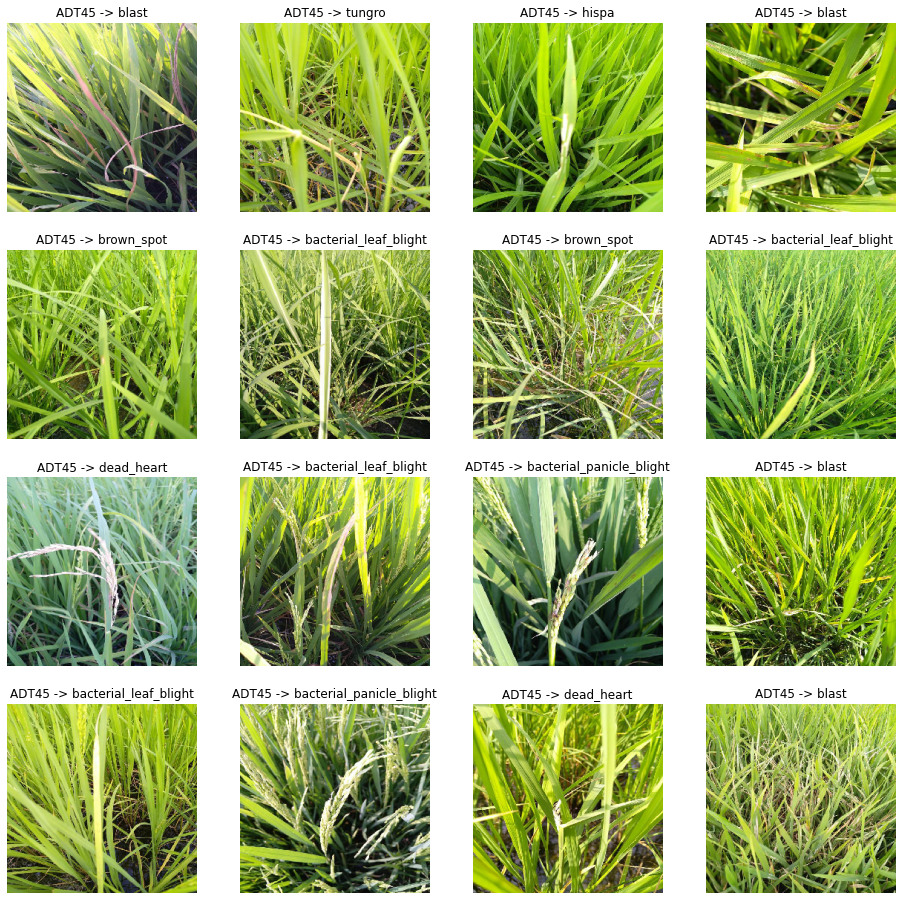

Seeing examples for IR20


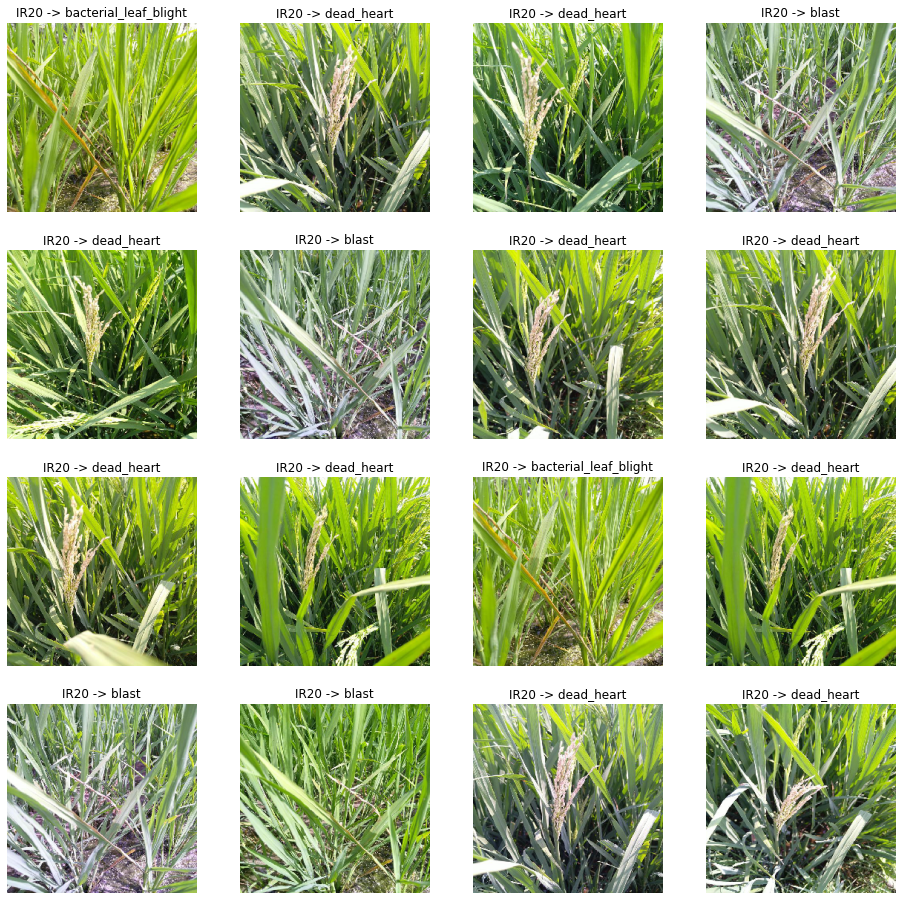

Seeing examples for KarnatakaPonni


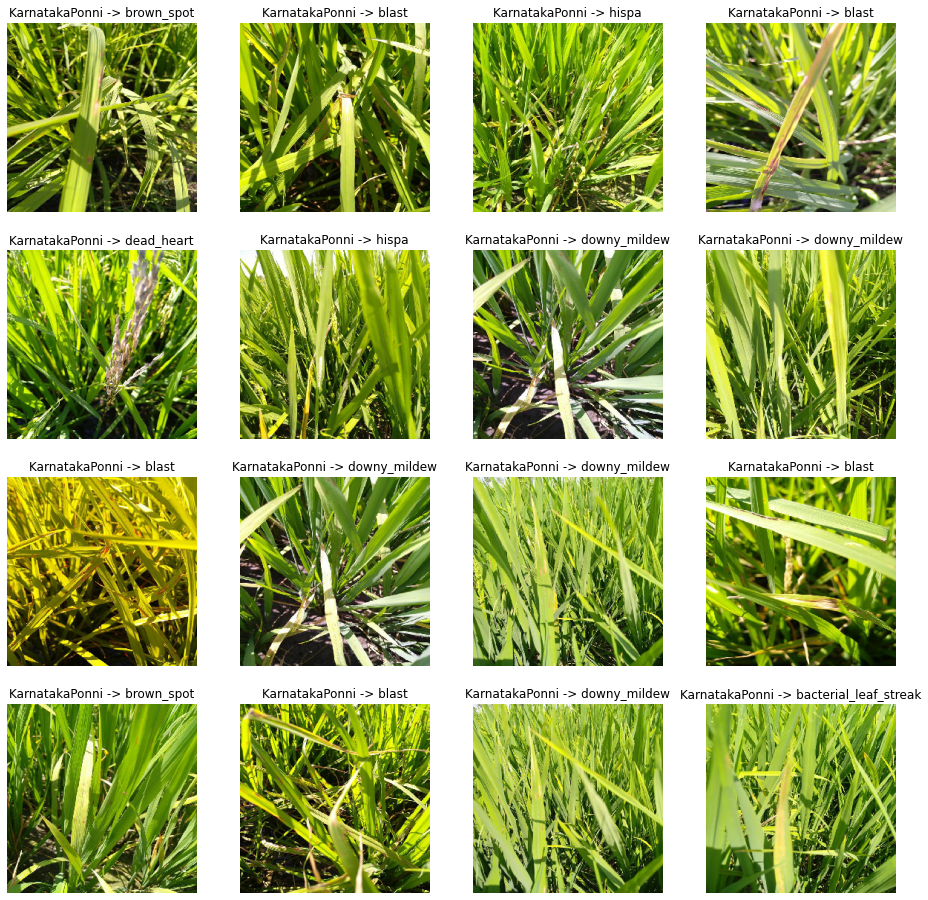

Seeing examples for Onthanel


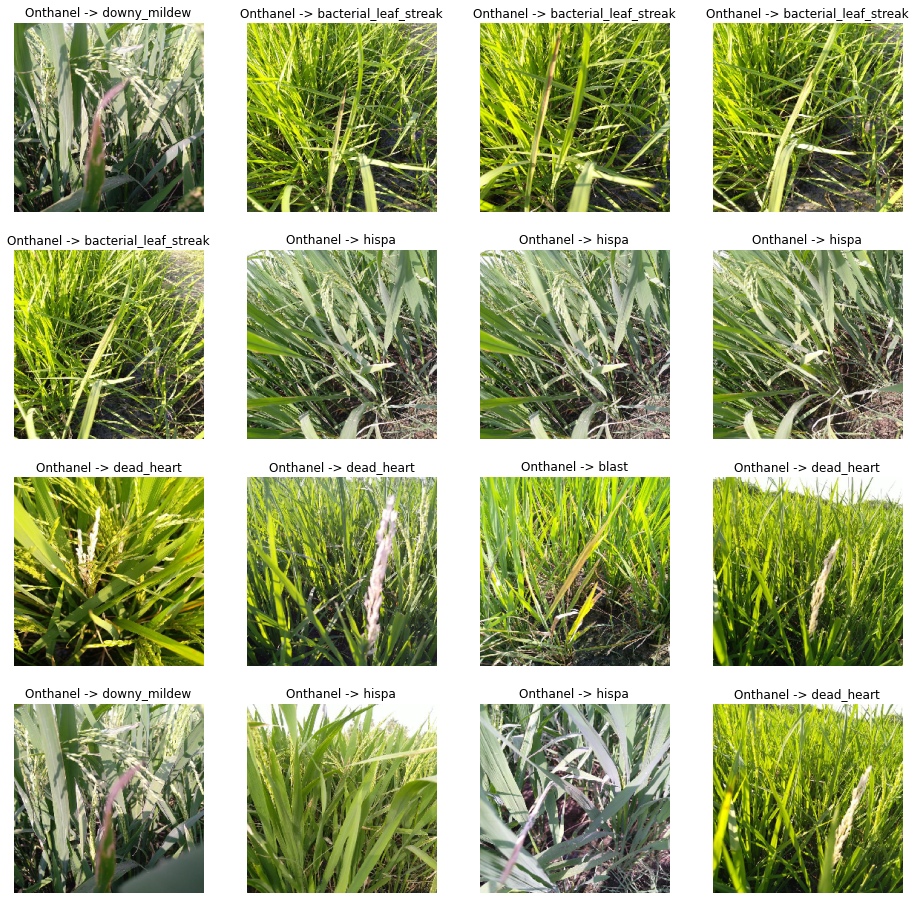

Seeing examples for Ponni


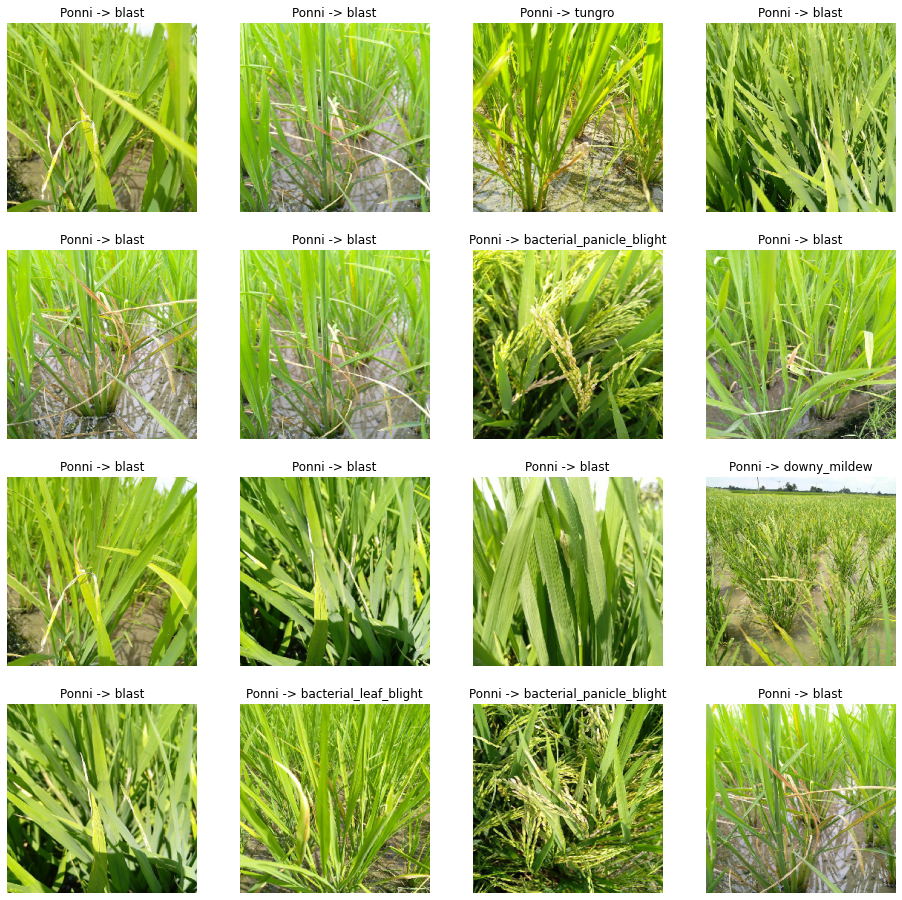

Seeing examples for Surya


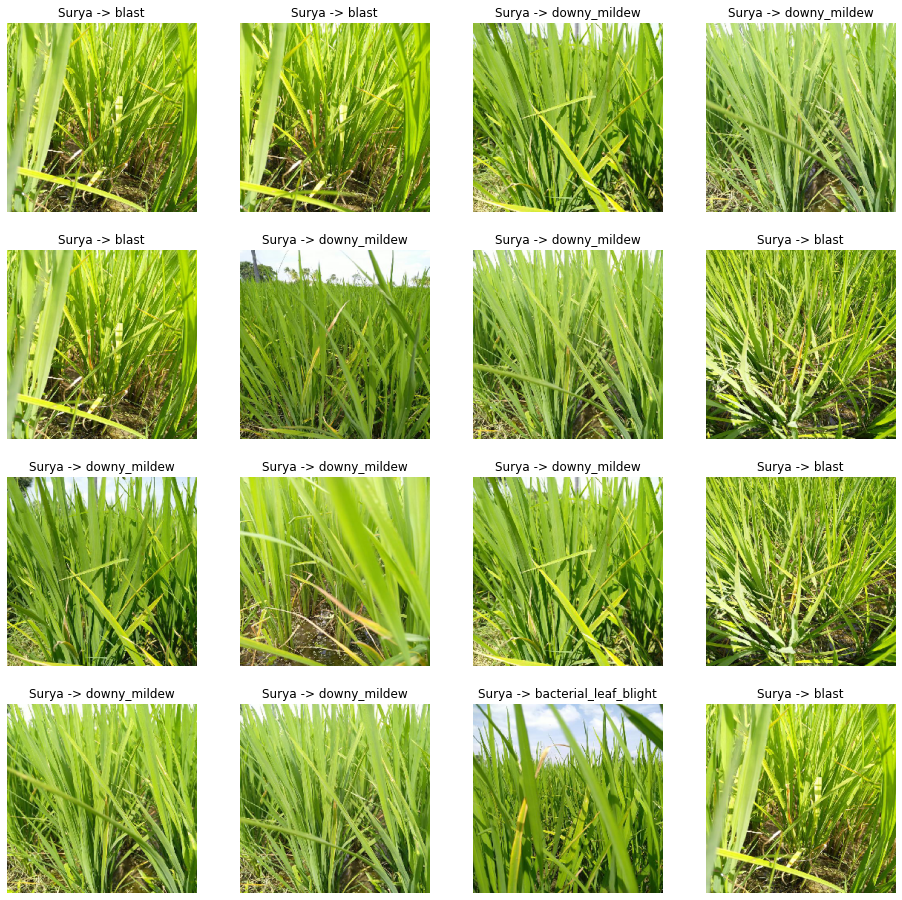

Seeing examples for Zonal


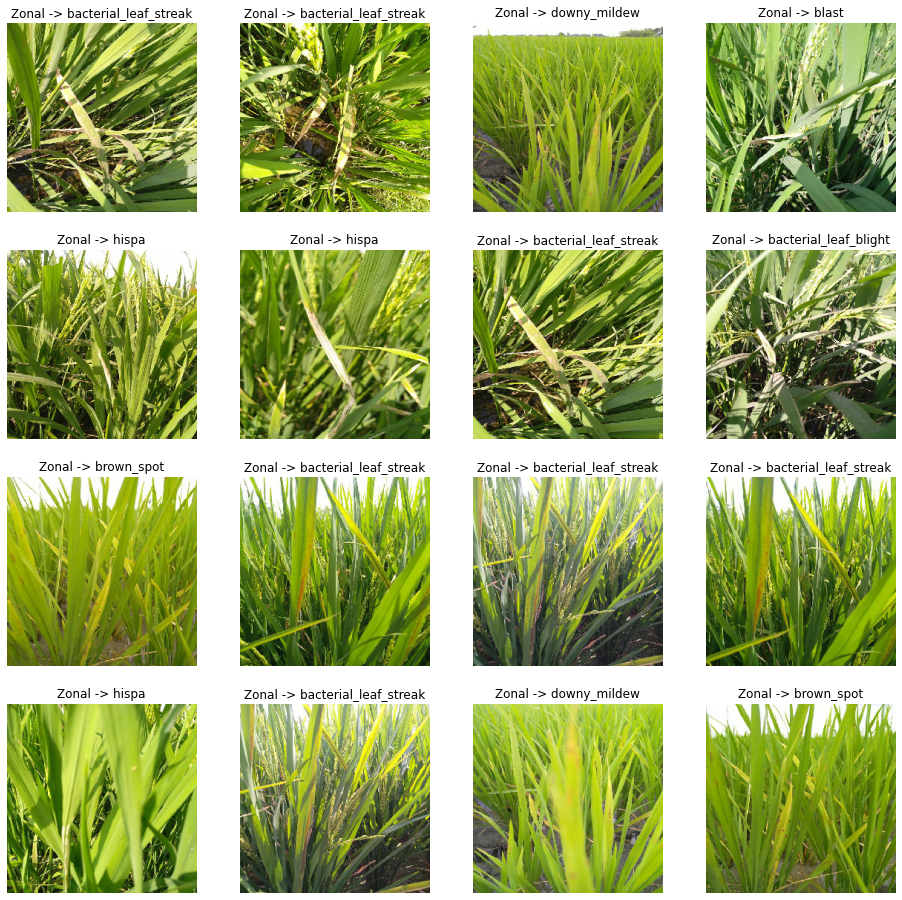

Seeing examples for AndraPonni


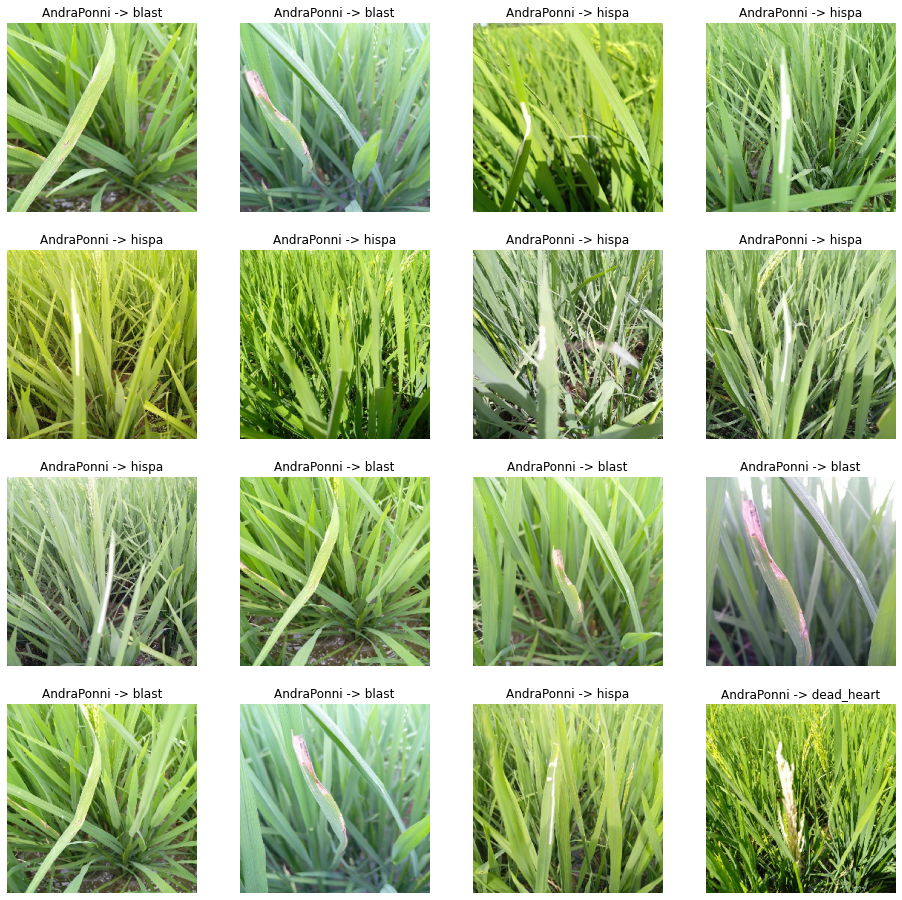

Seeing examples for AtchayaPonni


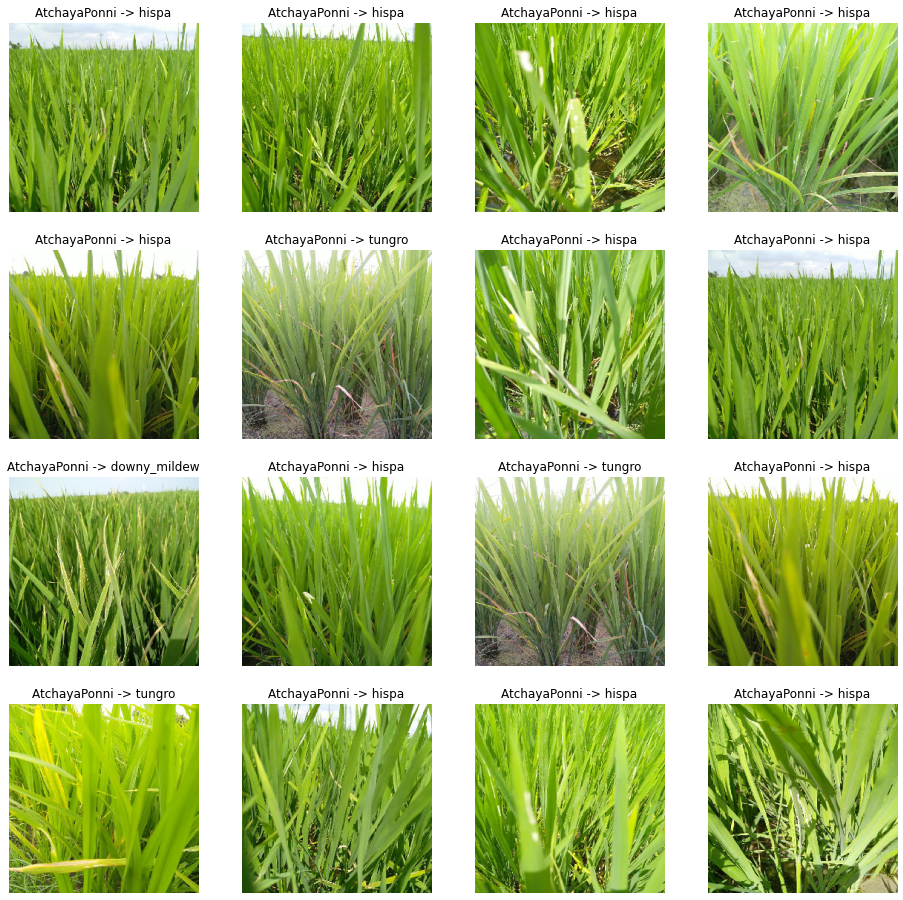

Seeing examples for RR


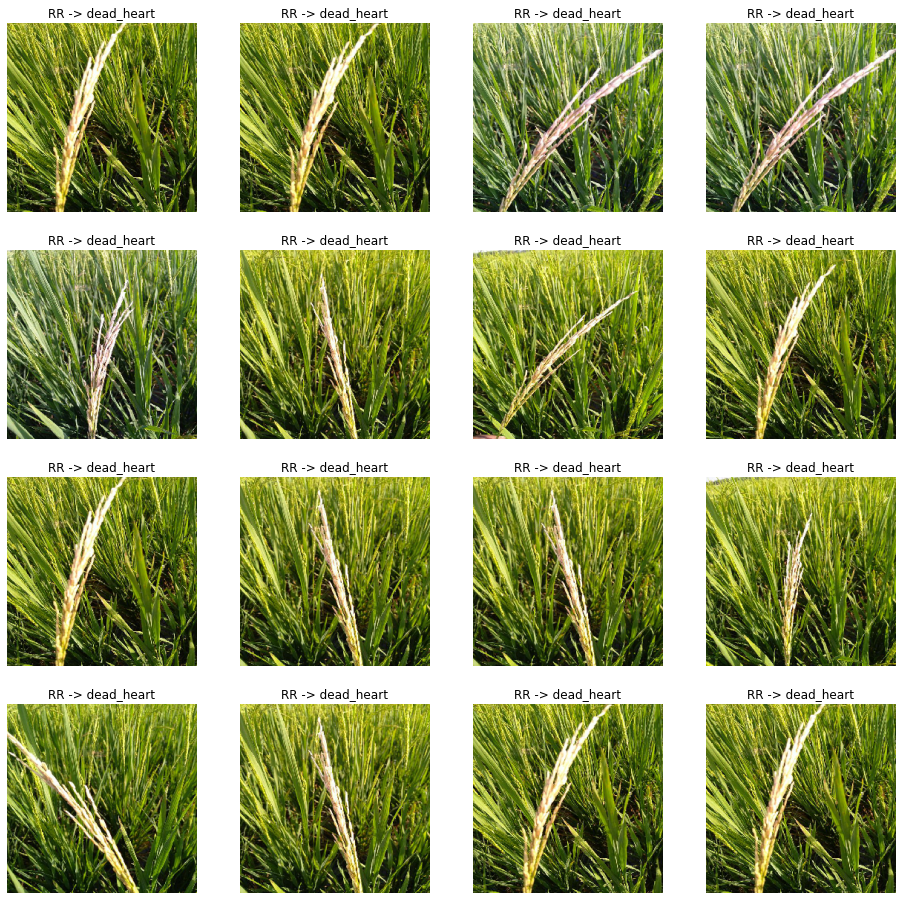

In [ ]:
# Seeing examples of diseased crops in each variety
for variety in np.ravel(varieties):
    variety_df = disease_df[disease_df['variety'] == variety]
    indices = np.random.randint(low=0, high=len(variety_df), size=(4,4))
    print(f'Seeing examples for {variety}')
    _, ax = plt.subplots(nrows=4, ncols=4, figsize=(16,16))
    for i in range(4):
        for j in range(4):
            img_path = os.path.join(BASE_PATH, variety_df.iloc[indices[i,j], 1], variety_df.iloc[indices[i,j], 0])
            img = img_to_array(load_img(img_path, target_size=(256,256,3)))/255.0
            ax[i,j].imshow(img)
            ax[i,j].axis('off')
            ax[i,j].set_title(f'{variety} -> {variety_df.iloc[indices[i,j], 1]}')
    plt.show()